## Analyse de la segmentation des images par seuillage 

### I. Import des modules et chargement des données

In [2]:
from pathlib import Path

import numpy as np 
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline
from PIL import Image
import cv2

In [3]:
df = pd.read_csv(Path("V2_Plant_Seedlings_DataFrame.csv"))
df.head()

,filepath,species,image_name,height,width,R_mean,G_mean,B_mean,luminosity,sharpness_score,image_size,square
0,Input\Maize\196.png,Maize,196.png,1260,1260,96.623133,95.263001,68.305443,86.730526,371.683979,1587600,square
1,Input\Cleavers\33.png,Cleavers,33.png,352,352,80.315397,70.118769,50.518635,66.984267,39.836262,123904,square
2,Input\Charlock\454.png,Charlock,454.png,990,990,80.529463,75.808330,55.868748,70.735514,305.574312,980100,square
3,Input\Small-flowered Cranesbill\5.png,Small-flowered Cranesbill,5.png,162,162,80.199131,71.348765,45.413733,65.653876,9.546821,26244,square
4,Input\Small-flowered Cranesbill\91.png,Small-flowered Cranesbill,91.png,323,323,83.221012,71.454773,45.279941,66.651909,31.808805,104329,square


In [6]:
df['species'].unique()

array(['Maize', 'Cleavers', 'Charlock', 'Small-flowered Cranesbill',
       'Scentless Mayweed', 'Black-grass', 'Common Chickweed', 'Fat Hen',
       "Shepherd's Purse", 'Sugar beet', 'Loose Silky-bent',
       'Common wheat'], dtype=object)

### II. Visualisation préliminaire des images brutes du dataset

In [4]:
# Fonction renvoyant x indices d'images par espèce, choisis aléatoirement

def random_indices(df,num_indices,num_spec=12):
    indices = []
    # On choisit num_spec espèces aléatoirement
    if num_spec > df['species'].nunique():
        print("Le nombre d'espèces est supérieur au maximum.")
    else:
        spec_indices = np.random.choice(df['species'].nunique(),
                                        size=num_spec,
                                        replace=False)
    # On choisit num_indices images pour chaque espèce
    for n in spec_indices:
        spec = df['species'].unique()[n]
        plants_indices = np.random.choice(df[df['species']==spec].index,
                                          size=num_indices if num_indices>1 else None,
                                          replace=False)
        indices.append(plants_indices)
    return indices

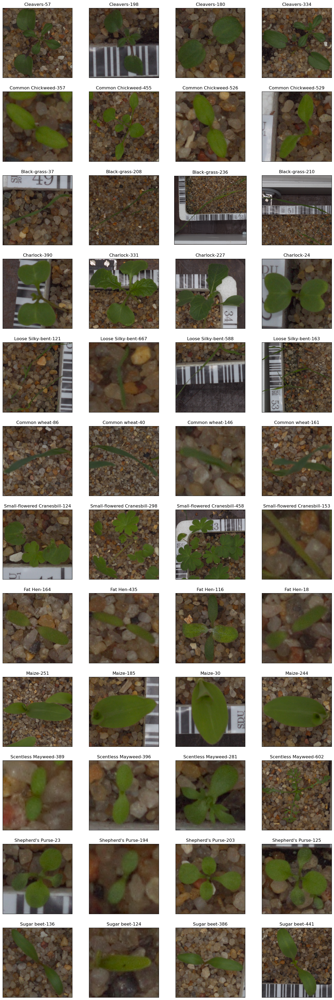

In [5]:
# Affichage de 4 images choisies aléatoirement par espèce 

nb_spec = 12
nb_img_per_row = 4

# Calcul des indices aléatoires des images
indices = random_indices(df,num_spec=nb_spec,num_indices=nb_img_per_row)

# Construction de la figure
fig,ax = plt.subplots(nb_spec,nb_img_per_row,figsize=(4*nb_img_per_row,4*nb_spec),subplot_kw=dict(xticks=[], yticks=[]))
for i in range(ax.shape[0]):
    for j in range(ax.shape[1]):
        index = indices[i][j]
        plant = df['species'].iloc[index] + '-' + df['image_name'].iloc[index].strip('.png')
        filepath = df['filepath'].iloc[index]
        img = np.array(Image.open(filepath))
        ax[i,j].imshow(img)
        ax[i,j].grid(False)
        ax[i,j].set_title(plant)
    

### III. Choix de l'espace de couleurs : analyse colorimétrique d'images dans les différents espaces

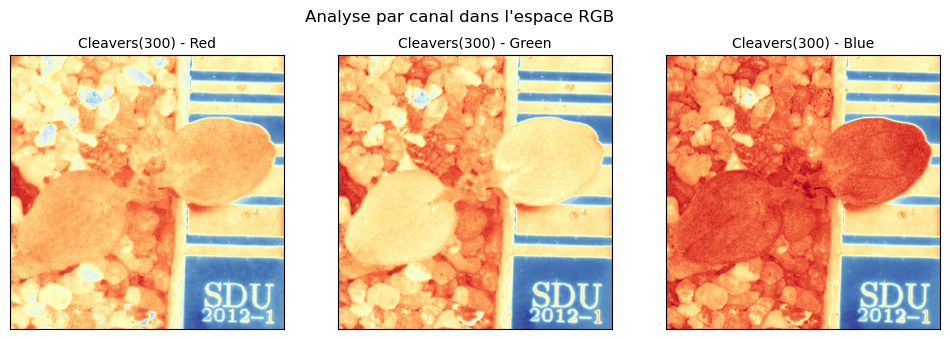

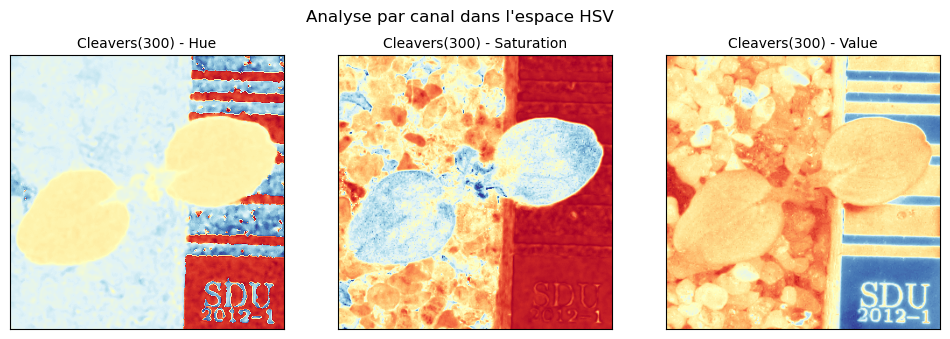

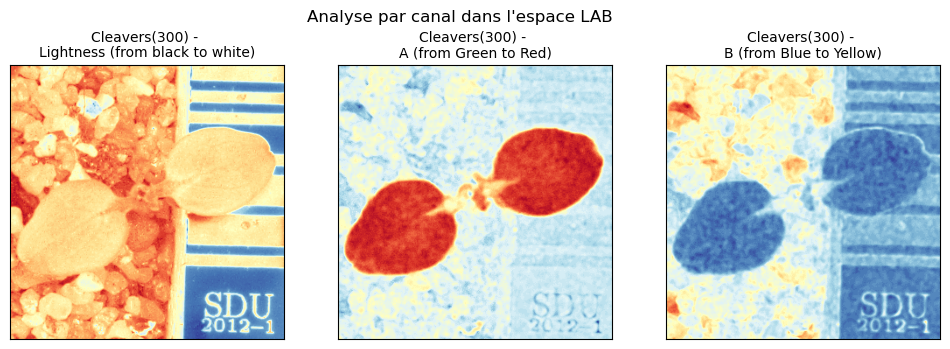

In [3]:
# Choix aléatoire d'une image dans le DataFrame
index = np.random.choice(df.index)
plant = df['species'].iloc[index] + '(' + df['image_name'].iloc[index].strip('.png') + ')'


# Ouverture de l'image (initialement au format BGR) et conversion dans les espaces HSV et LAB
img_rgb = np.array(Image.open(df['filepath'].iloc[index]))
img_hsv = cv2.cvtColor(img_rgb, cv2.COLOR_BGR2HSV)
img_lab = cv2.cvtColor(img_rgb, cv2.COLOR_BGR2LAB)


# Affichage des 3 canaux de l'image dans chacun des 3 espaces colorimétriques

titles=[["Red","Green","Blue"],
        ["Hue","Saturation","Value"],
        ["\nLightness (from black to white)","\nA (from Green to Red)","\nB (from Blue to Yellow)"]]

# Choix de la colormap
colormap = "RdYlBu"

# Analyse dans l'espace RGB
fig1,ax1 = plt.subplots(1,3,figsize=(12,5),subplot_kw=dict(xticks=[], yticks=[]))
fig1.suptitle("Analyse par canal dans l'espace RGB", y=0.86, fontsize=12)
for c in range(3):
    ax1[c].imshow(img_rgb[:,:,c],cmap=colormap)
    ax1[c].set_title(plant + " - " + titles[0][c],fontsize=10)
    
# Analyse dans l'espace HSV
fig2,ax2 = plt.subplots(1,3,figsize=(12,5),subplot_kw=dict(xticks=[], yticks=[]))
fig2.suptitle("Analyse par canal dans l'espace HSV", y=0.86, fontsize=12)
for c in range(3):
    ax2[c].imshow(img_hsv[:,:,c],cmap=colormap)
    ax2[c].set_title(plant + " - " + titles[1][c],fontsize=10)
    
# Analyse dans l'espace LAB
fig3,ax3 = plt.subplots(1,3,figsize=(12,5),subplot_kw=dict(xticks=[], yticks=[]))
fig3.suptitle("Analyse par canal dans l'espace LAB", y=0.88, fontsize=12)
for c in range(3):
    ax3[c].imshow(img_lab[:,:,c],cmap=colormap)
    ax3[c].set_title(plant + " - " + titles[2][c],fontsize=10)

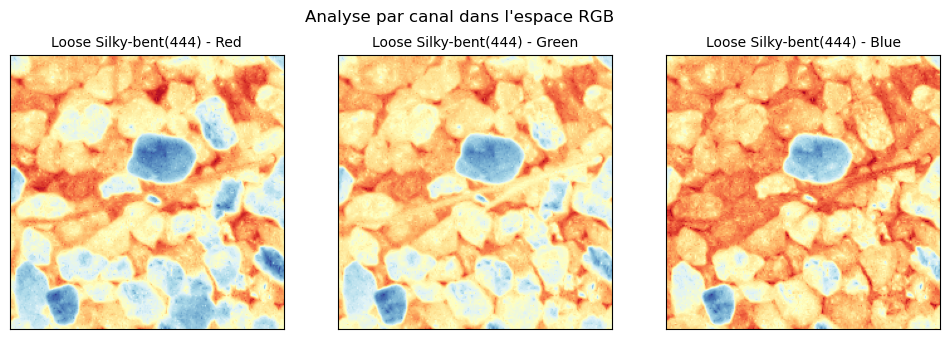

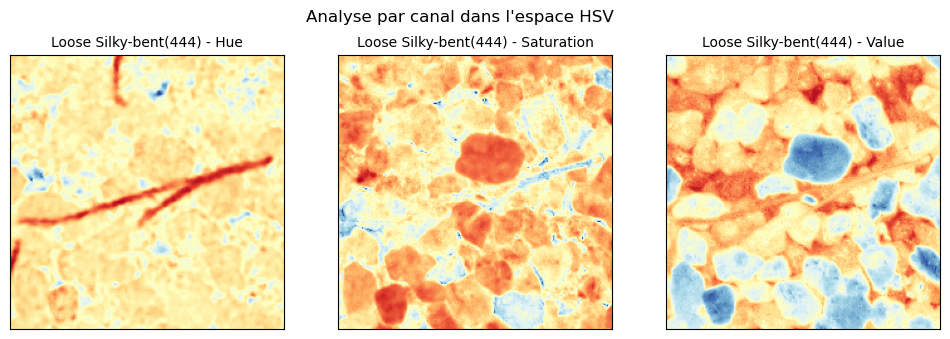

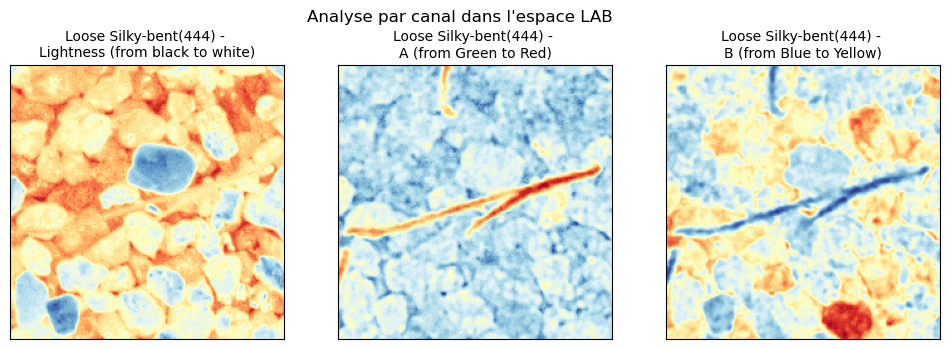

In [488]:
# Sélection d'une image dans le DataFrame
index = 1355
plant = df['species'].iloc[index] + '(' + df['image_name'].iloc[index].strip('.png') + ')'

# Ouverture de l'image (initialement au format RGB) et conversion dans les espaces HSV et LAB
img_rgb = np.array(Image.open(df['filepath'].iloc[index]))
img_hsv = cv2.cvtColor(img_rgb, cv2.COLOR_BGR2HSV)
img_lab = cv2.cvtColor(img_rgb, cv2.COLOR_BGR2LAB)

# Affichage des 3 canaux de l'image dans chacun des 3 espaces colorimétriques

titles=[["Red","Green","Blue"],
        ["Hue","Saturation","Value"],
        ["\nLightness (from black to white)","\nA (from Green to Red)","\nB (from Blue to Yellow)"]]

# Choix de la colormap
# colormap = "RdYlGn"
colormap = "RdYlBu"
# colormap = "Spectral"

# Analyse dans l'espace RGB
fig1,ax1 = plt.subplots(1,3,figsize=(12,5),subplot_kw=dict(xticks=[], yticks=[]))
fig1.suptitle("Analyse par canal dans l'espace RGB", y=0.86, fontsize=12)
for c in range(3):
    ax1[c].imshow(img_rgb[:,:,c],cmap=colormap)
    ax1[c].set_title(plant + " - " + titles[0][c],fontsize=10)
    
# Analyse dans l'espace HSV
fig2,ax2 = plt.subplots(1,3,figsize=(12,5),subplot_kw=dict(xticks=[], yticks=[]))
fig2.suptitle("Analyse par canal dans l'espace HSV", y=0.86, fontsize=12)
for c in range(3):
    ax2[c].imshow(img_hsv[:,:,c],cmap=colormap)
    ax2[c].set_title(plant + " - " + titles[1][c],fontsize=10)
    
# Analyse dans l'espace LAB
fig3,ax3 = plt.subplots(1,3,figsize=(12,5),subplot_kw=dict(xticks=[], yticks=[]))
fig3.suptitle("Analyse par canal dans l'espace LAB", y=0.88, fontsize=12)
for c in range(3):
    ax3[c].imshow(img_lab[:,:,c],cmap=colormap)
    ax3[c].set_title(plant + " - " + titles[2][c],fontsize=10)

### IV. Choix du seuil de segmentation

#### 1. Test de la méthode d'Otsu (détermination automatique du seuil de segmentation)

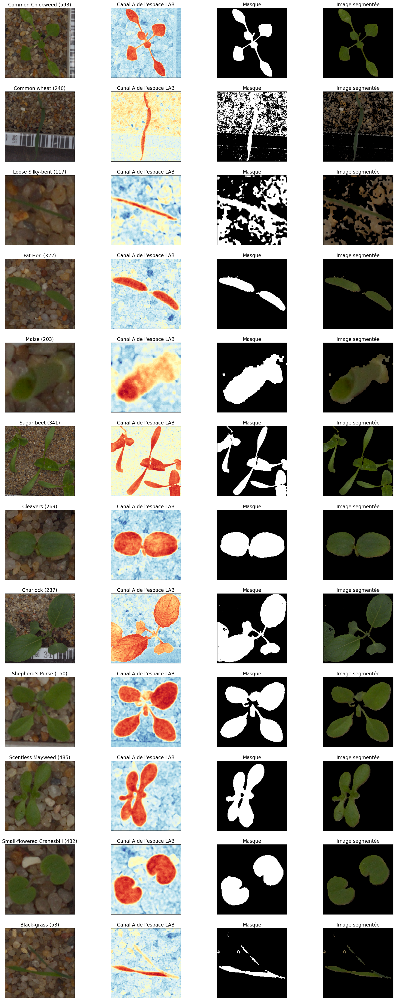

In [98]:
# Choix aléatoire d'une image par espèce
nb_spec = df['species'].nunique()
indices = random_indices(df,num_spec=nb_spec,num_indices=1)

# Segmentation par la méthode d'Otsu
fig,ax = plt.subplots(nb_spec,4,figsize=(25,5*nb_spec),subplot_kw=dict(xticks=[], yticks=[]))
for k,index in enumerate(indices):
    
    plant = df['species'].iloc[index] + ' (' + df['image_name'].iloc[index].strip('.png') + ')'
    img_rgb = np.array(Image.open(df['filepath'].iloc[index]))
    # Définition du masque par seuillage basique
    img_lab = cv2.cvtColor(img_rgb,cv2.COLOR_BGR2LAB)
    _,mask = cv2.threshold(img_lab[:,:,1],0,255,cv2.THRESH_BINARY_INV+cv2.THRESH_OTSU)
        # Elimination du bruit par ouverture puis fermeture
    kernel = np.ones((2,2))
    mask = cv2.morphologyEx(mask, cv2.MORPH_OPEN, kernel)
    mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, kernel)
    masked_img = cv2.bitwise_and(img_rgb,img_rgb,mask=mask)

    
    ax[k,0].imshow(img_rgb)
    ax[k,0].set_title(plant,fontsize=16)
    ax[k,1].imshow(img_lab[:,:,1],cmap="RdYlBu")
    ax[k,1].set_title("Canal A de l'espace LAB",fontsize=16)
    ax[k,2].imshow(mask,cmap='gray')
    ax[k,2].set_title("Masque",fontsize=16)
    ax[k,3].imshow(masked_img)
    ax[k,3].set_title("Image segmentée",fontsize=16)
    fig.subplots_adjust(wspace=0.1)

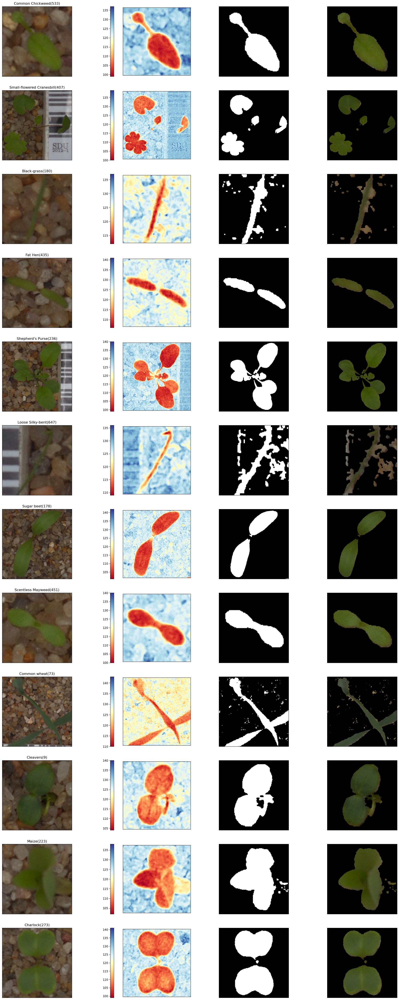

In [534]:
# Choix aléatoire d'une image par espèce
nb_spec = df['species'].nunique()
indices = random_indices(df,num_spec=nb_spec,num_indices=1)

# Segmentation par la méthode d'Otsu
fig,ax = plt.subplots(nb_spec,4,figsize=(25,5*nb_spec),subplot_kw=dict(xticks=[], yticks=[]))
for k,index in enumerate(indices):
    
    plant = df['species'].iloc[index] + ' (' + df['image_name'].iloc[index].strip('.png') + ')'
    img_rgb = np.array(Image.open(df['filepath'].iloc[index]))
    # Définition du masque par seuillage basique
    img_lab = cv2.cvtColor(img_rgb,cv2.COLOR_BGR2LAB)
    _,mask = cv2.threshold(img_lab[:,:,1],0,255,cv2.THRESH_BINARY_INV+cv2.THRESH_OTSU)
        # Elimination du bruit par ouverture puis fermeture
    kernel = np.ones((2,2))
    mask = cv2.morphologyEx(mask, cv2.MORPH_OPEN, kernel)
    mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, kernel)
    masked_img = cv2.bitwise_and(img_rgb,img_rgb,mask=mask)

    
    ax[k,0].imshow(img_rgb)
    ax[k,0].set_title(plant)
    ax1 = ax[k,1].imshow(img_lab[:,:,1],cmap="RdYlBu")
    fig.colorbar(ax1,ax=ax[k,1],location='left')
    ax[k,2].imshow(mask,cmap='gray')
    ax[k,3].imshow(masked_img)

#### 2. Détermination d'un seuil fixe de segmentation

##### Analyse du canal A de l'espace de couleurs LAB pour les différentes espèces 

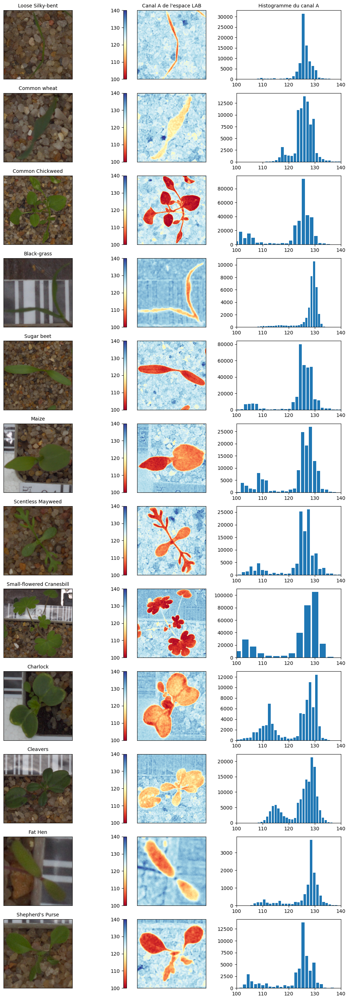

In [45]:
# Choix aléatoire d'une image par espèce
nb_spec = df['species'].nunique()
indices = random_indices(df,num_spec=nb_spec,num_indices=1)

# Visualisation pour chaque image du canal A de l'image (espace de couleurs LAB), et de l'histogramme correspondant
fig,ax = plt.subplots(nb_spec,3,figsize=(13,3*nb_spec))
for k,index in enumerate(indices):
    img_rgb = np.array(Image.open(df['filepath'].iloc[index]))
    ax[k,0].imshow(img_rgb)
    ax[k,0].set_xticks([])
    ax[k,0].set_yticks([])
    ax[k,0].set_title(df['species'].iloc[index],fontsize=10)
    img_lab = cv2.cvtColor(img_rgb,cv2.COLOR_BGR2LAB)
    ax1 = ax[k,1].imshow(img_lab[:,:,1],cmap="RdYlBu",vmin=100,vmax=140)
    fig.colorbar(ax1,ax=ax[k,1],location='left')
    ax[k,1].set_xticks([])
    ax[k,1].set_yticks([])
    ax[k,2].hist(img_lab[:,:,1].flatten(),rwidth = 0.8,bins=30)
    ax[k,2].set_xlim(100,140)
ax[0,1].set_title("Canal A de l'espace LAB",fontsize=10)
ax[0,2].set_title("Histogramme du canal A",fontsize=10);  

##### Test de plusieurs valeurs de seuil de segmentation

In [ ]:
# Définition d'une fonction effectuant une segmentation par seuillage, suivie d'une ouverture/fermeture

def threshold_segmentation(img_rgb,threshold):
    # Conversion dans l'espace LAB
    img_lab = cv2.cvtColor(img_rgb,cv2.COLOR_BGR2LAB)
    # Redimensionnement des images
    img_rgb = cv2.resize(img_rgb,(224,224))
    img_lab = cv2.resize(img_lab,(224,224))
    # Segmentation basique par seuillage
    _,mask = cv2.threshold(img_lab[:,:,1],threshold,255,cv2.THRESH_BINARY_INV)
    # Elimination du bruit par ouverture puis fermeture
    kernel = np.ones((2,2))
    mask = cv2.morphologyEx(mask, cv2.MORPH_OPEN, kernel)
    mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, kernel)
    masked_img = cv2.bitwise_and(img_rgb,img_rgb,mask=mask)
    return masked_img

######  1. Seuil de segmentation = 116

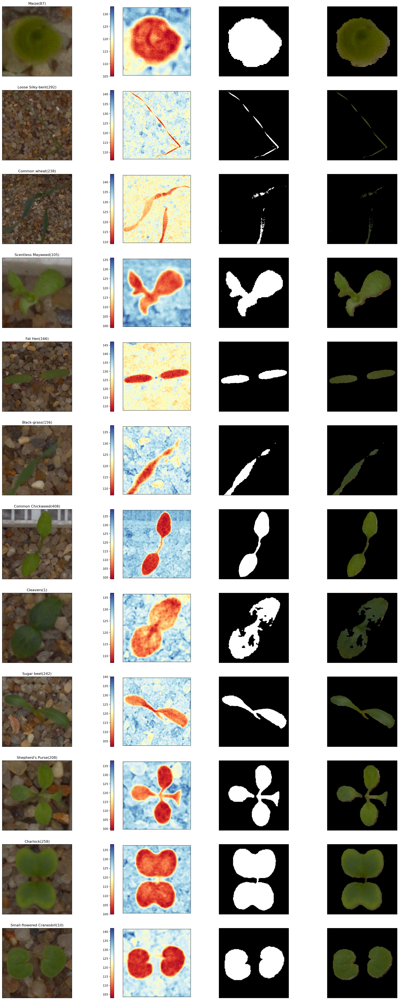

In [47]:
# Choix aléatoire d'une image par espèce
nb_spec = df['species'].nunique()
indices = random_indices(df,num_spec=nb_spec,num_indices=1)

segmentation_threshold = 116
fig,ax = plt.subplots(nb_spec,4,figsize=(25,5*nb_spec),subplot_kw=dict(xticks=[], yticks=[]))
for k,index in enumerate(indices):
    
    plant = df['species'].iloc[index] + '(' + df['image_name'].iloc[index].strip('.png') + ')'
    img_rgb = np.array(Image.open(df['filepath'].iloc[index]))
    masked_img = threshold_segmentation(img_rgb,segmentation_threshold)
    
    ax[k,0].imshow(img_rgb)
    ax[k,0].set_title(plant)
    ax1 = ax[k,1].imshow(img_lab[:,:,1],cmap="RdYlBu")
    fig.colorbar(ax1,ax=ax[k,1],location='left')
    ax[k,2].imshow(mask,cmap='gray')
    ax[k,3].imshow(masked_img)


######  2. Seuil de segmentation = 118

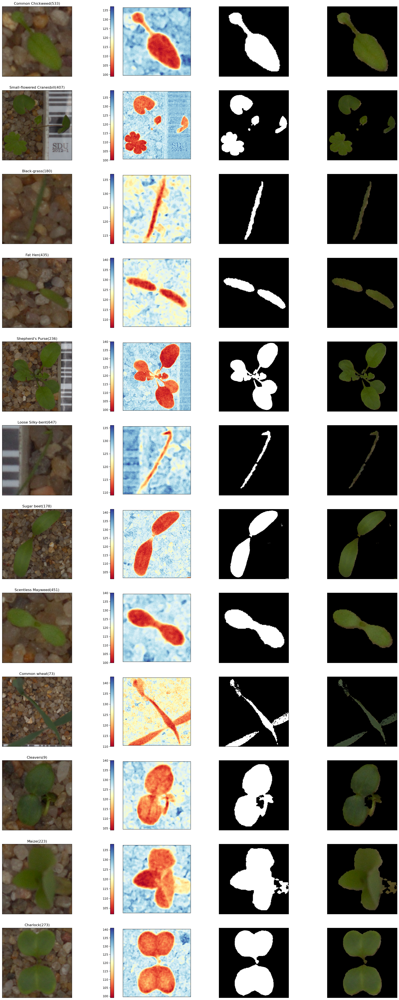

In [505]:
# Choix aléatoire d'une image par espèce
nb_spec = df['species'].nunique()
indices = random_indices(df,num_spec=nb_spec,num_indices=1)

segmentation_threshold = 118
fig,ax = plt.subplots(nb_spec,4,figsize=(25,5*nb_spec),subplot_kw=dict(xticks=[], yticks=[]))
for k,index in enumerate(indices):
    
    plant = df['species'].iloc[index] + '(' + df['image_name'].iloc[index].strip('.png') + ')'
    img_rgb = np.array(Image.open(df['filepath'].iloc[index]))
    masked_img = threshold_segmentation(img_rgb,segmentation_threshold)
    
    ax[k,0].imshow(img_rgb)
    ax[k,0].set_title(plant)
    ax1 = ax[k,1].imshow(img_lab[:,:,1],cmap="RdYlBu")
    fig.colorbar(ax1,ax=ax[k,1],location='left')
    ax[k,2].imshow(mask,cmap='gray')
    ax[k,3].imshow(masked_img)


######  3. Seuil de segmentation = 120

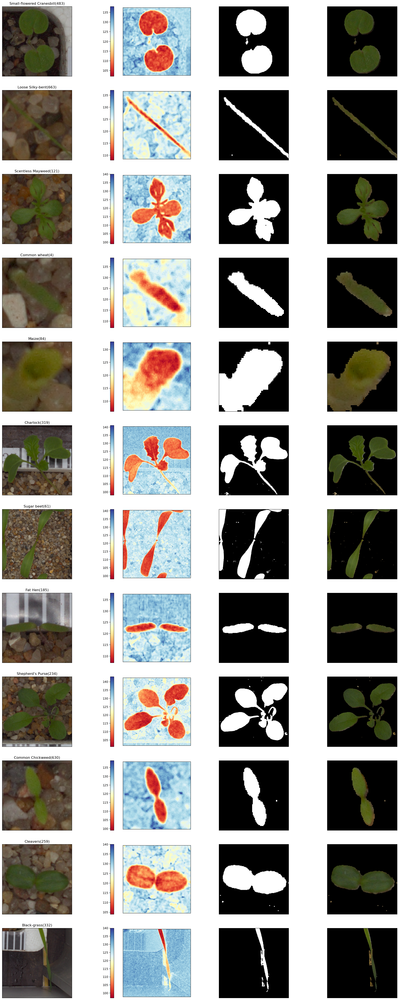

In [46]:
# Choix aléatoire d'une image par espèce
nb_spec = df['species'].nunique()
indices = random_indices(df,num_spec=nb_spec,num_indices=1)

segmentation_threshold = 120
fig,ax = plt.subplots(nb_spec,4,figsize=(25,5*nb_spec),subplot_kw=dict(xticks=[], yticks=[]))
for k,index in enumerate(indices):
    
    plant = df['species'].iloc[index] + '(' + df['image_name'].iloc[index].strip('.png') + ')'
    img_rgb = np.array(Image.open(df['filepath'].iloc[index]))
    masked_img = threshold_segmentation(img_rgb,segmentation_threshold)
    
    ax[k,0].imshow(img_rgb)
    ax[k,0].set_title(plant)
    ax1 = ax[k,1].imshow(img_lab[:,:,1],cmap="RdYlBu")
    fig.colorbar(ax1,ax=ax[k,1],location='left')
    ax[k,2].imshow(mask,cmap='gray')
    ax[k,3].imshow(masked_img)


######  4. Seuil de segmentation = 121

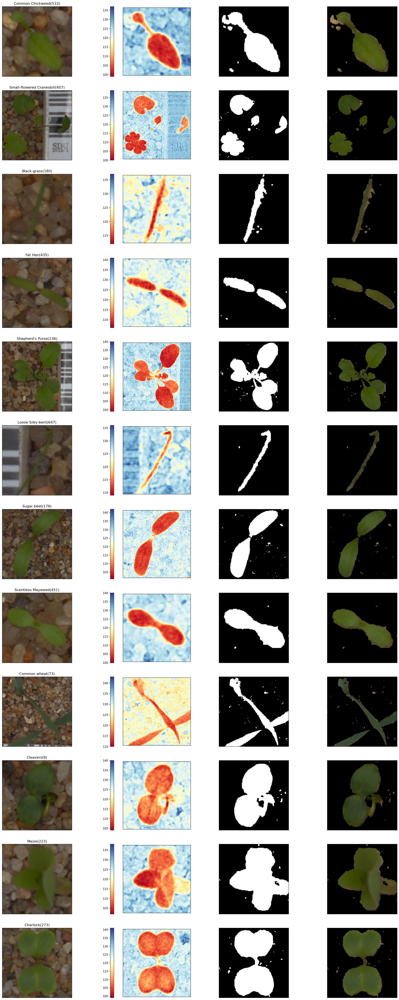

In [506]:
segmentation_threshold = 121
fig,ax = plt.subplots(nb_spec,4,figsize=(25,5*nb_spec),subplot_kw=dict(xticks=[], yticks=[]))
for k,index in enumerate(indices):
    
    plant = df['species'].iloc[index] + '(' + df['image_name'].iloc[index].strip('.png') + ')'
    img_rgb = np.array(Image.open(df['filepath'].iloc[index]))
    masked_img = threshold_segmentation(img_rgb,segmentation_threshold)
    
    ax[k,0].imshow(img_rgb)
    ax[k,0].set_title(plant)
    ax1 = ax[k,1].imshow(img_lab[:,:,1],cmap="RdYlBu")
    fig.colorbar(ax1,ax=ax[k,1],location='left')
    ax[k,2].imshow(mask,cmap='gray')
    ax[k,3].imshow(masked_img)


######  5. Comparaison des différents seuils de segmentation pour une image donnée

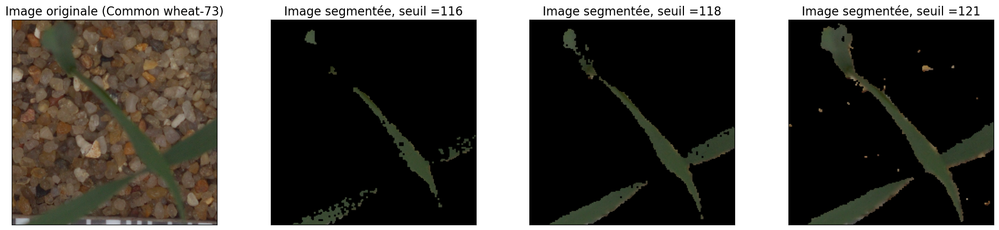

In [104]:
index = 4859
thresholds = [116,118,121]

img_rgb = np.array(Image.open(df['filepath'].iloc[index]))

fig,ax = plt.subplots(1,4,figsize=(25,5),subplot_kw=dict(xticks=[], yticks=[]))

# Affichage de l'image originale
plant = df['species'].iloc[index] + '-' + df['image_name'].iloc[index].strip('.png')
ax[0].imshow(img_rgb)
ax[0].set_title("Image originale (" + plant + ")",fontsize=16)

# Segmentation avec les différentes valeurs de seuil et affichage des images segmentées
segm_imgs = [threshold_segmentation(img_rgb,t) for t in thresholds]   
for k in range(len(thresholds)):
    ax[k+1].imshow(segm_imgs[k])
    ax[k+1].set_title("Image segmentée, seuil ="+str(thresholds[k]),fontsize=16)
fig.subplots_adjust(wspace=0.01)

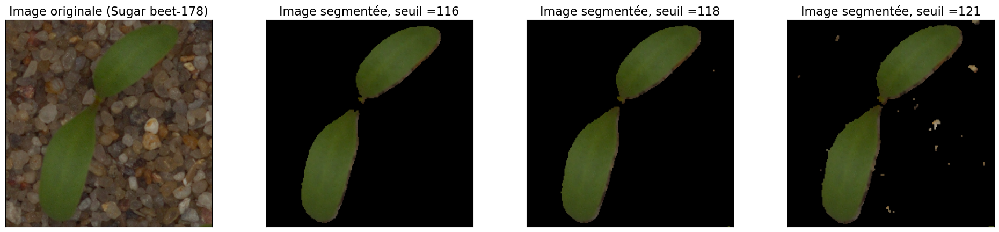

In [103]:
index = 903
thresholds = [116,118,121]

img_rgb = np.array(Image.open(df['filepath'].iloc[index]))

fig,ax = plt.subplots(1,4,figsize=(25,5),subplot_kw=dict(xticks=[], yticks=[]))

# Affichage de l'image originale
plant = df['species'].iloc[index] + '-' + df['image_name'].iloc[index].strip('.png')
ax[0].imshow(img_rgb)
ax[0].set_title("Image originale (" + plant + ")",fontsize=16)

# Segmentation avec les différentes valeurs de seuil et affichage des images segmentées
segm_imgs = [threshold_segmentation(img_rgb,t) for t in thresholds]   
for k in range(len(thresholds)):
    ax[k+1].imshow(segm_imgs[k])
    ax[k+1].set_title("Image segmentée, seuil ="+str(thresholds[k]),fontsize=16)
fig.subplots_adjust(wspace=0.01)

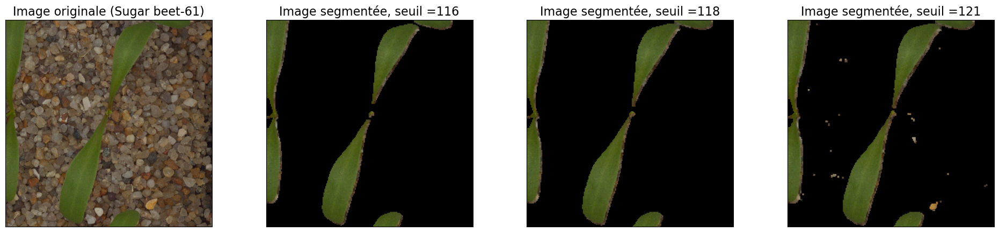

In [102]:
index = 2958
thresholds = [116,118,121]

img_rgb = np.array(Image.open(df['filepath'].iloc[index]))

fig,ax = plt.subplots(1,4,figsize=(25,5),subplot_kw=dict(xticks=[], yticks=[]))

# Affichage de l'image originale
plant = df['species'].iloc[index] + '-' + df['image_name'].iloc[index].strip('.png')
ax[0].imshow(img_rgb)
ax[0].set_title("Image originale (" + plant + ")",fontsize=16)

# Segmentation avec les différentes valeurs de seuil et affichage des images segmentées
segm_imgs = [threshold_segmentation(img_rgb,t) for t in thresholds]   
for k in range(len(thresholds)):
    ax[k+1].imshow(segm_imgs[k])
    ax[k+1].set_title("Image segmentée, seuil ="+str(thresholds[k]),fontsize=16)
fig.subplots_adjust(wspace=0.01)

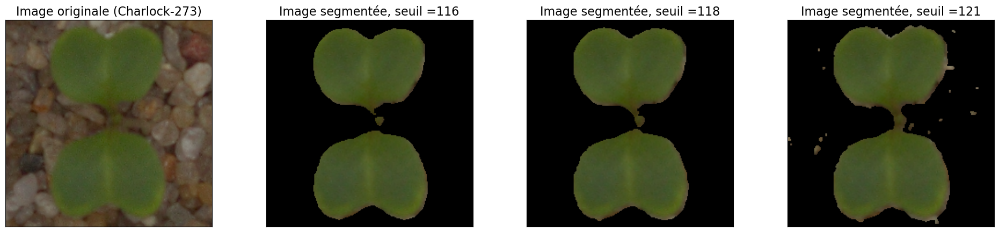

In [101]:
index = 643
thresholds = [116,118,121]

img_rgb = np.array(Image.open(df['filepath'].iloc[index]))

fig,ax = plt.subplots(1,4,figsize=(25,5),subplot_kw=dict(xticks=[], yticks=[]))

# Affichage de l'image originale
plant = df['species'].iloc[index] + '-' + df['image_name'].iloc[index].strip('.png')
ax[0].imshow(img_rgb)
ax[0].set_title("Image originale (" + plant + ")",fontsize=16)

# Segmentation avec les différentes valeurs de seuil et affichage des images segmentées
segm_imgs = [threshold_segmentation(img_rgb,t) for t in thresholds]   
for k in range(len(thresholds)):
    ax[k+1].imshow(segm_imgs[k])
    ax[k+1].set_title("Image segmentée, seuil ="+str(thresholds[k]),fontsize=16)
fig.subplots_adjust(wspace=0.01)

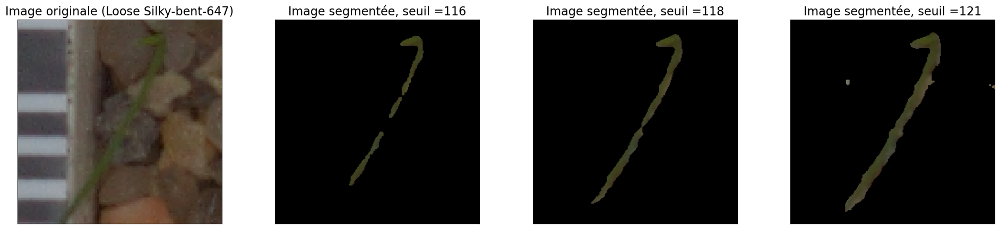

In [105]:
index = 4389
thresholds = [116,118,121]

img_rgb = np.array(Image.open(df['filepath'].iloc[index]))

fig,ax = plt.subplots(1,4,figsize=(25,5),subplot_kw=dict(xticks=[], yticks=[]))

# Affichage de l'image originale
plant = df['species'].iloc[index] + '-' + df['image_name'].iloc[index].strip('.png')
ax[0].imshow(img_rgb)
ax[0].set_title("Image originale (" + plant + ")",fontsize=16)

# Segmentation avec les différentes valeurs de seuil et affichage des images segmentées
segm_imgs = [threshold_segmentation(img_rgb,t) for t in thresholds]   
for k in range(len(thresholds)):
    ax[k+1].imshow(segm_imgs[k])
    ax[k+1].set_title("Image segmentée, seuil ="+str(thresholds[k]),fontsize=16)
fig.subplots_adjust(wspace=0.01)

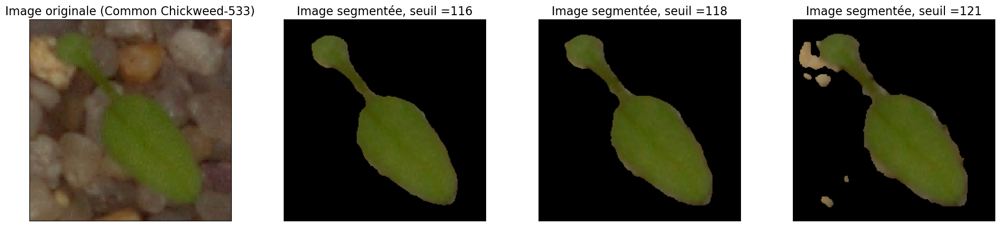

In [106]:
index = 1252
thresholds = [116,118,121]

img_rgb = np.array(Image.open(df['filepath'].iloc[index]))

fig,ax = plt.subplots(1,4,figsize=(25,5),subplot_kw=dict(xticks=[], yticks=[]))

# Affichage de l'image originale
plant = df['species'].iloc[index] + '-' + df['image_name'].iloc[index].strip('.png')
ax[0].imshow(img_rgb)
ax[0].set_title("Image originale (" + plant + ")",fontsize=16)

# Segmentation avec les différentes valeurs de seuil et affichage des images segmentées
segm_imgs = [threshold_segmentation(img_rgb,t) for t in thresholds]   
for k in range(len(thresholds)):
    ax[k+1].imshow(segm_imgs[k])
    ax[k+1].set_title("Image segmentée, seuil ="+str(thresholds[k]),fontsize=16)
fig.subplots_adjust(wspace=0.01)

### V. Résultats

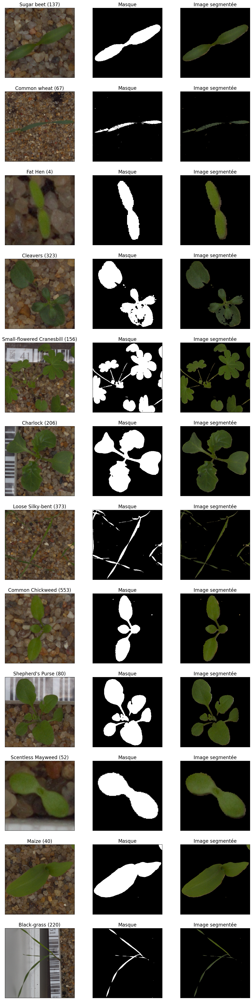

In [139]:
# Choix aléatoire d'une image par espèce
nb_spec = df['species'].nunique()
indices = random_indices(df,num_spec=nb_spec,num_indices=1)

segmentation_threshold = 118
fig,ax = plt.subplots(nb_spec,3,figsize=(15,5*nb_spec),subplot_kw=dict(xticks=[], yticks=[]))
for k,index in enumerate(indices):
    
    plant = df['species'].iloc[index] + ' (' + df['image_name'].iloc[index].strip('.png') + ')'
    img_rgb = np.array(Image.open(df['filepath'].iloc[index]))
    # Définition du masque par seuillage basique
    img_lab = cv2.cvtColor(img_rgb,cv2.COLOR_BGR2LAB)
    _,mask = cv2.threshold(img_lab[:,:,1],segmentation_threshold,255,cv2.THRESH_BINARY_INV)
    # Elimination du bruit par ouverture puis fermeture
    kernel = np.ones((2,2))
    mask = cv2.morphologyEx(mask, cv2.MORPH_OPEN, kernel)
    mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, kernel)
    masked_img = cv2.bitwise_and(img_rgb,img_rgb,mask=mask)
    
    ax[k,0].imshow(img_rgb)
    ax[k,0].set_title(plant,fontsize=16)
    ax[k,1].imshow(mask,cmap='gray')
    ax[k,1].set_title("Masque",fontsize=16)
    ax[k,2].imshow(masked_img)
    ax[k,2].set_title("Image segmentée",fontsize=16);